#### GWBT  1980-1989 vs. Future changes
- 1) Annual mean & maximum
- 2) Trend of annual mean/maximum  
- 3.1) Monthly mean & maximum
- 3.2) Trend of monthly mean  
- 4) Mean annual number of days exceed Black Flag days over 1980-1989 
- 5) Mean annual Number of days exceed Black Flag days for each hour of the day

In [5]:
import os.path
import calendar
import numpy as np
import xarray as xr
import datetime
#import scipy.spatial.qhull as qhull 
import pymannkendall as mk
 
from calendar import monthrange
import scipy
import scipy.spatial.qhull as qhull
from scipy import stats

import matplotlib.pyplot as plt 
import pandas as pd
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import cartopy.feature as cf

import sys
sys.path.append("/glade/u/home/mingge/PYTHON")
from importlib import reload
import interp_func
reload(interp_func)
 
from interp_func import interp_weights, interpolate

In [6]:
def ax_coastlines_country(ax_s):
    ax_s.coastlines(lw=1.5, resolution='110m')
    ax_s.add_feature(cfeature.STATES.with_scale('110m'), zorder=3, linewidth=1.5, edgecolor='g')
    # mask ocean 
    ax_s.add_feature(cfeature.OCEAN, facecolor='white', zorder=1) 


In [7]:
def plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, vmin, vmax, nlevel, vabs, title_s, cmap = ['RdBu_r', 'RdBu_r', 'RdBu_r']):
    fig = plt.figure(figsize=(22, 8))
    level_s = np.linspace(vmin, vmax, nlevel) 
    level_d = np.linspace(0, vabs, 10) 
    cbar_kwargs = {'orientation':'horizontal', 'shrink':0.6, "pad" : .05, 'aspect':40, 'label':'2 Metre Temperature Anomaly [K]'}
    
    for nf in range(1,4):
        ax = fig.add_subplot(1, 3, nf, projection= ccrs.PlateCarree())
     
        # Set lat/lon bounding box and feature resolutions.
        ax.set_extent([-130, -60, 25, 50])
        
        levels = level_s
        
        if nf==1:
            data_n = data1_2d
        elif nf == 2:
            data_n = data2_2d
        else:
            data_n = data2_2d - data1_2d
            levels = level_d
            vmax = vabs
            vmin = 0
        
        mm = plt.contourf(lon_2d, lat_2d, data_n, 
                      cmap = cmap[nf-1], extend='both',
                      vmin = vmin, vmax = vmax, levels = levels,
                      transform=ccrs.PlateCarree())
        
        ax.coastlines()
        ax_coastlines_country(ax)
        
        plt.colorbar(mm, orientation='horizontal', pad=0.05, extend='both')    
     
        gl = ax.gridlines(draw_labels=True)   
        gl.xlines = gl.ylines = False

        plt.title(title_s[nf-1], fontweight="bold",fontsize=14)


In [59]:
def plot_p3_yuma(data1_2d, data2_2d, lat_2d, lon_2d, vmin, vmax, nlevel, vabs, title_s, cmap = ['RdBu_r', 'RdBu_r', 'RdBu_r']):
    fig = plt.figure(figsize=(22, 12))
    level_s = np.linspace(vmin, vmax, nlevel) 
    level_d = np.linspace(0, vabs, 10) 
    cbar_kwargs = {'orientation':'horizontal', 'shrink':0.6, "pad" : .05, 'aspect':40, 'label':'2 Metre Temperature Anomaly [K]'}
    
    flnm = '/glade/campaign/mmm/c3we/prein/CONUS404/data/restart_file/wrfrst_d01_1990-01-01_00:00:00'
    with xr.open_dataset(flnm) as ds:
        hgt = ds.HGT[0]
    
    for nf in range(1,4):
        ax = fig.add_subplot(1, 3, nf, projection= ccrs.PlateCarree())
     
        # Set lat/lon bounding box and feature resolutions.
        ax.set_extent([-114-2, -114+2, 32.5-2, 32.5+2])
        
        levels = level_s
        
        if nf==1:
            data_n = data1_2d
        elif nf == 2:
            data_n = data2_2d
        else:
            data_n = data2_2d - data1_2d
            levels = level_d
            vmax = vabs
            vmin = 0
            
        mm = plt.contourf(lon_2d, lat_2d, data_n, 
                      cmap = cmap[nf-1], extend='both',
                      vmin = vmin, vmax = vmax, levels = levels,
                      transform=ccrs.PlateCarree())
        ax.contour (lon_2d, lat_2d, hgt, vmin = 0, vmax=3000, levels = np.linspace(0, 4000, 13),
               linewidths=0.5, colors='black', linestyles='dashed') 
        #ax.contour(lon_2d, lat_2d, hgt, vmin = 0, vmax=3000, 
        #                 levels = np.linspace(0, 3000, 11), color='black')
        #ax.coastlines()
        #ax_coastlines_country(ax)
        ax.add_feature(cfeature.BORDERS.with_scale('50m'))
        ax.add_feature(cfeature.STATES.with_scale('50m'))
        
        plt.colorbar(mm, orientation='horizontal', pad=0.05, extend='both')    
     
        gl = ax.gridlines(draw_labels=True)   
        gl.xlines = gl.ylines = False

        plt.title(title_s[nf-1], fontweight="bold",fontsize=14)


In [8]:
def plot_hatches_p3(data1, data2, lat_2d, lon_2d, n_year, method, title_s, vabs, vmin=0, vmax=30, n_level=11):
    '''
    method: mean_mk, max_mx, max, mean, TBFhour_training
    '''
    #var_ss = 'GWBT'
    #model_s = [ 'CONUS404']
    #title_s = ['1980-1989','future','future - current']
    fig = plt.figure(figsize=(22, 10))
    levels = np.linspace(vmin, vmax, n_level) 
    cbar_kwargs = {'orientation':'horizontal', 'shrink':0.6, "pad" : .05, 'aspect':40, 'label':'2 Metre Temperature Anomaly [K]'}

    # A p -value less than 0.05 (typically ≤ 0.05) 
    for nv in range(3):
        ax = fig.add_subplot(1, 3, nv+1, projection= ccrs.PlateCarree())
        ax.set_extent([-130, -60, 25, 50])
       
        if nv == 0:
            data_p = data1[0]
            data_s = data1[1].values
        elif nv ==1:
            data_p = data2[0]
            data_s = data2[1].values
        else:
            data_p = data2[0] - data1[0]
            data_s = data2[1].values - data1[1].values
        
        if nv !=2:
            mm = plt.contourf(lon_2d, lat_2d, data_s*(n_year-1), 
                      cmap = 'Reds', extend='both',
                      vmin = vmin, vmax = vmax, levels = levels,
                      transform=ccrs.PlateCarree())
    
            # hatching <0.05
            plt.contourf(lon_2d, lat_2d, data_p, levels=[-99, 0.05, 99],
                    colors='none', hatches=['///', '']) #, alpha=.5)
        else:
            mm = plt.contourf(lon_2d, lat_2d, data_s*(n_year-1), 
                      cmap = 'Reds', extend='both',
                      vmin = 0, vmax = vabs, levels=np.linspace(0, vabs, n_level),
                      transform=ccrs.PlateCarree())
            
        ax.coastlines()
        
        ax.add_feature(cfeature.STATES.with_scale('110m'), zorder=3, linewidth=0.5, edgecolor='g')
        # mask ocean 
        ax.add_feature(cfeature.OCEAN, facecolor='white', zorder=1)
        cbar = plt.colorbar(mm, orientation='horizontal', pad=0.03, extend='both')
        if nv !=2:
            cbar.set_label('GWBT Trend [over '+ str(n_year) +' years]')
        else:
            cbar.set_label('GWBT Trend difference [over '+ str(n_year) +' years]')
        plt.title(title_s[nv], fontweight="bold", fontsize=14)
        

#### GWBT  1980-1989 vs. Future changes
- setups

In [9]:
year_s = 1980
year_e = 1989
n_year = year_e - year_s + 1

method_s = ['mean', 'max']
n_method = len(method_s)

senario = ['future'] # ['current', 'future']
n_sena = len(senario)

dir_o = '/glade/campaign/mmm/c3we/mingge/DOD/'
dir_if = '/glade/campaign/mmm/c3we/prein/CONUS404/data/MonthlyData_PGW/GWBT/'
dir_of =  dir_o + 'GWBT_Future/'

- 1) Annual mean and maximum

In [ ]:
for method in method_s:
    flnm_o = dir_of + 'GWBT_CONUS404_annual_' + method + '_1980-1989.nc'
    if os.path.exists(flnm_o):
        print(flnm_o, 'exist')
        with xr.open_dataset(flnm_o) as ds_c:
            print(flnm_o)
            lat_2d = ds_c.lat
            lon_2d = ds_c.lon
            n_lat = lat_2d.shape[0]
            n_lon = lat_2d.shape[1]
    else:  
        is_first = True
        for year in range(year_s, year_e + 1):
            for month in range(1, 13):
                yyyymm = year*100 + month
                flnm_i = dir_if + 'GWBT_' +  str(yyyymm) + '_CONUS404.nc'
                with xr.open_dataset(flnm_i) as ds:
                    print(flnm_i)
                    data_0 = ds['__xarray_dataarray_variable__'].values
                    if method == 'mean':
                        data_d = np.mean(data_0.reshape((int(data_0.shape[0]/24), 24, data_0.shape[1], data_0.shape[2])),
                                         axis = 1)
                    elif method == 'max':
                        data_d = np.max(data_0, axis = 0)[None, :, :]
                                             
                    # concatenate/append numpy data  
                    if month == 1:
                        data_y = data_d.copy()
                        if is_first == True:
                            data_3d = np.zeros((n_year, data_y.shape[1], data_y.shape[2]))
                            is_first = False                     
                    else:
                        data_y = np.append(data_y, data_d, axis=0)
                
                    if month == 12:
                        if method == 'mean':
                            data_3d[year-year_s] = np.mean(data_y, axis=0)
                        elif method == 'max':
                            data_3d[year-year_s] = np.amax(data_y, axis=0)                        
         
        da = xr.DataArray(data = data_3d,
                          coords={'time': range(year_s, year_e + 1),'lat': ds.lat, 'lon': ds.lon}, 
                          dims=["time", "y", "x"],
                          attrs={'script':'Ming Ge: wgbt_wrf_cmp.ipynb' } )
            
        # create and write out dataset 
        ds = da.to_dataset(name = 'GWBT')         
        ds.to_netcdf(flnm_o)
        print(flnm_o)    
 

- 1.1) Mean GWBT (1980-1989)

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_mean.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_mean_1980-1989.nc


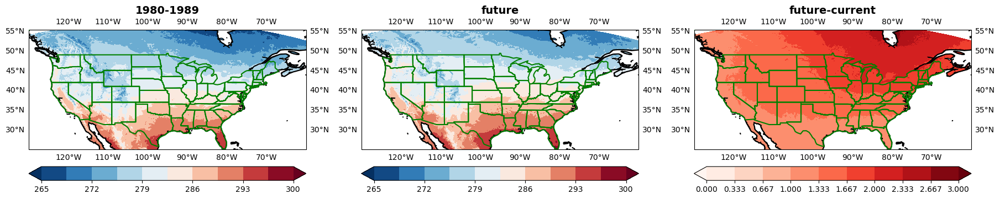

In [8]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_mean.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_mean_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_2d = ds_c.GWBT[:10].mean(dim='time')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_2d = ds_f.GWBT.mean(dim='time')

plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, 265, 300, 11, 3, title_s, color_1d)

 - 1.2) Mean annual maximum GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_max.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_max_1980-1989.nc
finish


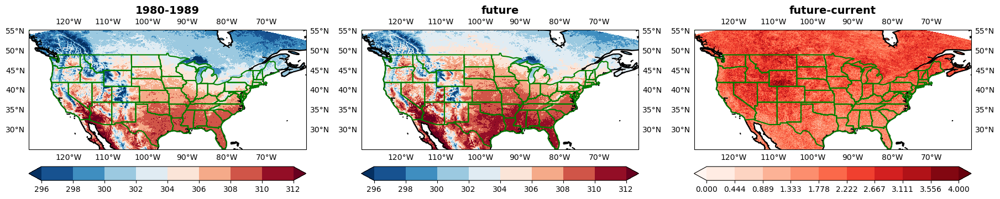

In [33]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_max.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_max_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_2d = ds_c.GWBT[:10].mean(dim='time')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_2d = ds_f.GWBT.mean(dim='time')

plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, 296, 312, 9, 4, title_s, color_1d)
print('finish')

#### 2) Trend changes

In [24]:
for nm in range(len(method_s)):
    flnm_i = dir_o + 'GWBT_CONUS404_annual_' + method_s[nm] + '.nc'
    flnm_o = dir_o + 'GWBT_CONUS404_annual_' + method_s[nm]+ '_mk_1980-1989.nc'
    
    if os.path.exists(flnm_o):
        print(flnm_o, 'exist')
        with xr.open_dataset(flnm_o) as ds:
            print(flnm_o)
            data_3d = ds['GWBT']
            lat_conus = ds.lat.values
            lon_conus = ds.lon.values
            n_lat_conus  = data_3d.shape[1]
            n_lon_conus  = data_3d.shape[2]
    else:
        with xr.open_dataset(flnm_i) as ds:
            #print(ds,flnm_i)
            data_3d = ds['GWBT'][:10]
            n_year = data_3d.shape[0]
            n_lat_conus  = data_3d.shape[1]
            n_lon_conus  = data_3d.shape[2]
        
        mk_3d = np.zeros((2, n_lat_conus, n_lon_conus)) 
        for ni in range(n_lat_conus):
            print(ni)
            for nj in range(n_lon_conus):
                res = mk.original_test(data_3d[:,ni, nj])
                #slope_2d[ni, nj] = np.polyfit(range(data_3d.shape[0]), data_3d[:,ni, nj],1)[0]
                mk_3d[0, ni, nj] = res.p
                mk_3d[1, ni, nj] = res.slope
         
        da = xr.DataArray(data = mk_3d,
                          coords={'mk': range(2), 'lat': ds.lat, 'lon': ds.lon}, 
                          dims=["mk", "y", "x"],
                          attrs = {'mk':'0:p_value, 1:slope', 'script':'Ming Ge: wgbt_wrf_cmp.ipynb' })
                    
        ds = da.to_dataset(name='GWBT')         
        ds.to_netcdf(flnm_o)
        print(flnm_o)   

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_max_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_max_mk_1980-1989.nc


In [26]:
for nm in range(len(method_s)):
    flnm_i = dir_of + 'GWBT_CONUS404_annual_' + method_s[nm] + '_1980-1989.nc'
    flnm_o = dir_of + 'GWBT_CONUS404_annual_' + method_s[nm]+ '_mk_1980-1989.nc'
    
    if os.path.exists(flnm_o):
        print(flnm_o, 'exist')
        with xr.open_dataset(flnm_o) as ds:
            print(flnm_o)
            data_3d = ds['GWBT']
            lat_conus = ds.lat.values
            lon_conus = ds.lon.values
            n_lat_conus  = data_3d.shape[1]
            n_lon_conus  = data_3d.shape[2]
    else:
        with xr.open_dataset(flnm_i) as ds:
            #print(ds,flnm_i)
            data_3d = ds['GWBT'][:10]
            n_year = data_3d.shape[0]
            n_lat_conus  = data_3d.shape[1]
            n_lon_conus  = data_3d.shape[2]
        
        mk_3d = np.zeros((2, n_lat_conus, n_lon_conus)) 
        for ni in range(n_lat_conus):
            print(ni)
            for nj in range(n_lon_conus):
                res = mk.original_test(data_3d[:,ni, nj])
                #slope_2d[ni, nj] = np.polyfit(range(data_3d.shape[0]), data_3d[:,ni, nj],1)[0]
                mk_3d[0, ni, nj] = res.p
                mk_3d[1, ni, nj] = res.slope
         
        da = xr.DataArray(data = mk_3d,
                          coords={'mk': range(2), 'lat': ds.lat, 'lon': ds.lon}, 
                          dims=["mk", "y", "x"],
                          attrs = {'mk':'0:p_value, 1:slope', 'script':'Ming Ge: wgbt_wrf_cmp.ipynb' })
                    
        ds = da.to_dataset(name='GWBT')         
        ds.to_netcdf(flnm_o)
        print(flnm_o)   


/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_max_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_max_mk_1980-1989.nc


- 2.1) Trend of annual mean GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_mean_mk_1980-1989.nc


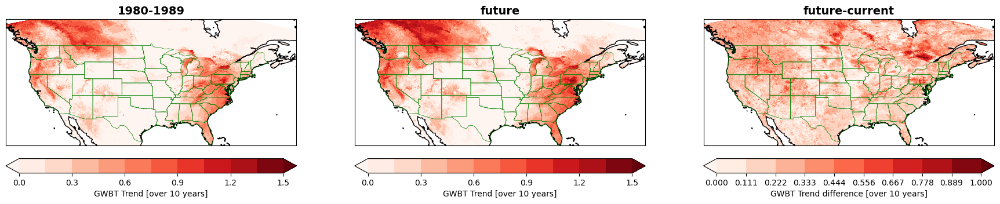

In [15]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_mean_mk_1980-1989.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_mean_mk_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'RdBu_r']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1 = ds_c.GWBT 
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2 = ds_f.GWBT 

plot_hatches_p3(data1, data2, lat_2d, lon_2d, n_year, method, title_s, 1, vmin=0, vmax=1.5, n_level=11)

2.2) Trend of annual max GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_max_mk_1980-1989.nc


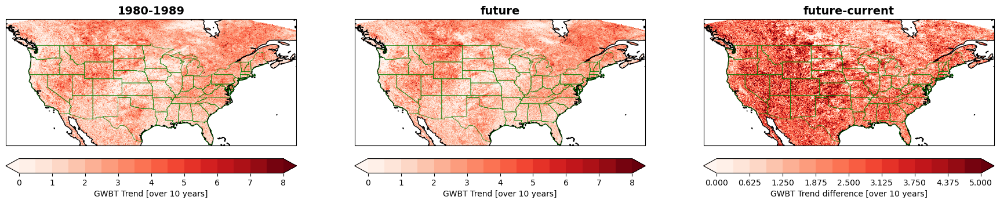

In [13]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_max_mk_1980-1989.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_max_mk_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'RdBu_r']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1 = ds_c.GWBT 
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2 = ds_f.GWBT 

plot_hatches_p3(data1, data2, lat_2d, lon_2d, n_year, method, title_s, 5, vmin=0, vmax=8, n_level=17)

- 3) Monthly mean and maximum

In [53]:
dir_i = '/glade/campaign/mmm/c3we/ESTCP/CONUS404/GWBT/'
 
n_month = 12

for method in method_s:
    flnm_o = dir_o + 'GWBT_CONUS404_yyyymm_' + method + '_1980-1989.nc'
    if os.path.exists(flnm_o):
        print(flnm_o, 'exist')
        #with xr.open_dataset(flnm_o) as ds:
        #    n_tbf_c = ds.n_TBF.sum(dim='month').mean(dim='year')
    else: 
        is_first = True
        for year in range(year_s, year_e + 1):
            for month in range(1, 12 + 1):
                flnm = dir_i + 'GWBT_' + str(year)+ str(month).zfill(2) + '_CONUS404.nc'           
                with xr.open_dataset(flnm) as ds:
                    print(flnm)
                    data_0 = ds.GWBT.values
                    if is_first == True:
                        n_lat = data_0.shape[1]
                        n_lon = data_0.shape[2]
                        data_4d = np.zeros((n_year, n_month, n_lat, n_lon))
                        is_first = False
                    data_d = data_0.reshape((int(data_0.shape[0]/24), 24, n_lat, n_lon))
                    if method == 'mean':
                        data_4d[year-year_s, month-1] = np.mean(data_d, axis=(0,1))
                    elif method == 'max':
                        data_4d[year-year_s, month-1] = np.max(data_d,  axis=(0,1))
                
        da = xr.DataArray(data = data_4d,
                    coords = {'year': range(year_s, year_e +1,1),
                              'month': range(1, 13),
                              'lat': ds.lat, 
                              'lon': ds.lon}, 
                    dims = ["year", "month", "y", "x"],
                    attrs = {'script':'Ming Ge: wgbt_wrf_cmp.ipynb'})
                            
                   
        # create and write out dataset 
        ds = da.to_dataset(name = 'GWBT' )         
        ds.to_netcdf(flnm_o)
        print(flnm_o) 

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_yyyymm_mean_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_yyyymm_max_1980-1989.nc exist


In [46]:
dir_i = '/glade/campaign/mmm/c3we/ESTCP/CONUS404/GWBT/'
dir_if =  '/glade/campaign/mmm/c3we/prein/CONUS404/data/MonthlyData_PGW/GWBT/'
n_month = 12

for method in method_s:
    flnm_o = dir_of + 'GWBT_CONUS404_yyyymm_' + method + '_1980-1989.nc'
    if os.path.exists(flnm_o):
        print(flnm_o, 'exist')
        #with xr.open_dataset(flnm_o) as ds:
        #    n_tbf_c = ds.n_TBF.sum(dim='month').mean(dim='year')
    else: 
        is_first = True
        for year in range(year_s, year_e + 1):
            for month in range(1, 12 + 1):
                flnm = dir_if + 'GWBT_' + str(year)+ str(month).zfill(2) + '_CONUS404.nc'           
                with xr.open_dataset(flnm) as ds:
                    print(flnm)
                    data_0 = ds.__xarray_dataarray_variable__.values
                    if is_first == True:
                        n_lat = data_0.shape[1]
                        n_lon = data_0.shape[2]
                        data_4d = np.zeros((n_year, n_month, n_lat, n_lon))
                        is_first = False
                    data_d = data_0.reshape((int(data_0.shape[0]/24), 24, n_lat, n_lon))
                    if method == 'mean':
                        data_4d[year-year_s, month-1] = np.mean(data_d,  axis=(0,1))
                    elif method == 'max':
                        data_4d[year-year_s, month-1] = np.max(data_d,  axis=(0,1))
                
        da = xr.DataArray(data = data_4d,
                    coords = {'year': range(year_s, year_e +1,1),
                              'month': range(1, 13),
                              'lat': ds.lat, 
                              'lon': ds.lon}, 
                    dims = ["year", "month", "y", "x"],
                    attrs = {'script':'Ming Ge: wgbt_wrf_cmp.ipynb'})
                            
                   
        # create and write out dataset 
        ds = da.to_dataset(name = 'GWBT' )         
        ds.to_netcdf(flnm_o)
        print(flnm_o) 

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_yyyymm_mean_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_yyyymm_max_1980-1989.nc exist


- 3.1) monthly mean GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_yyyymm_mean_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_yyyymm_mean_1980-1989.nc


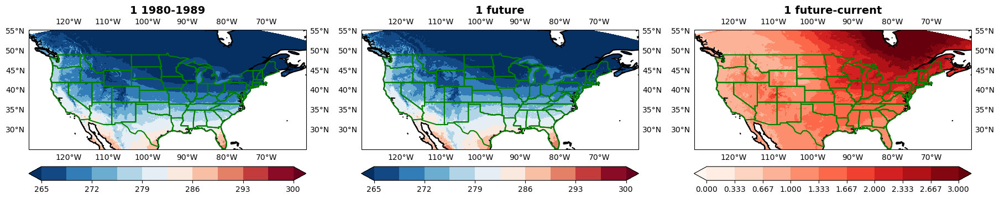

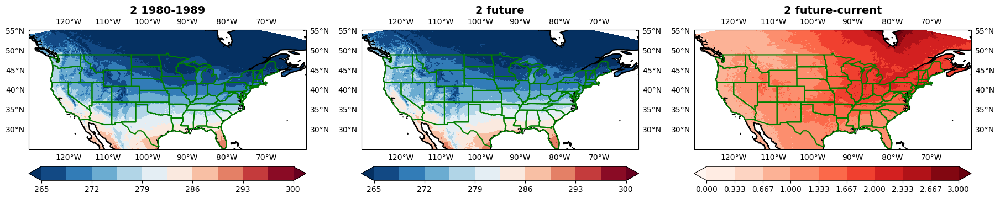

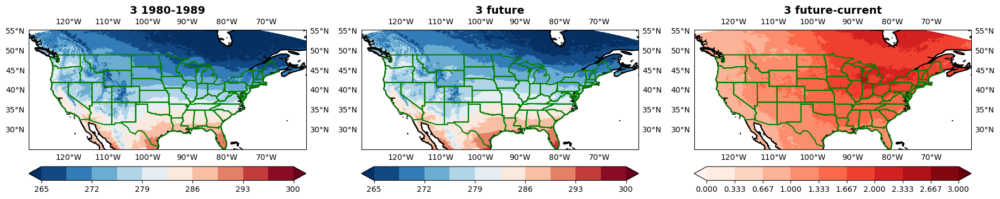

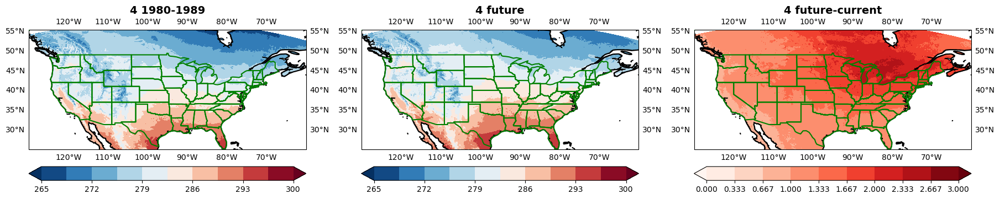

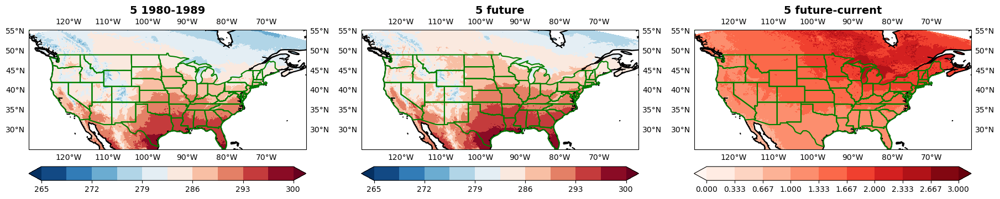

...

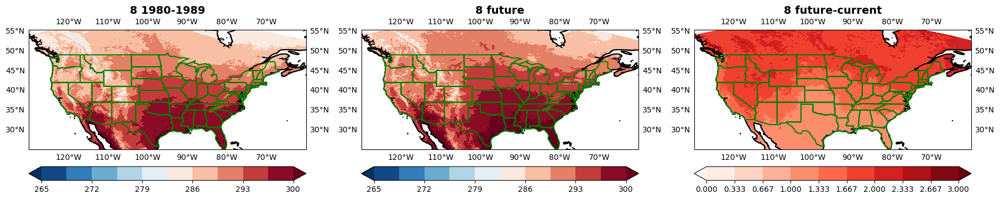

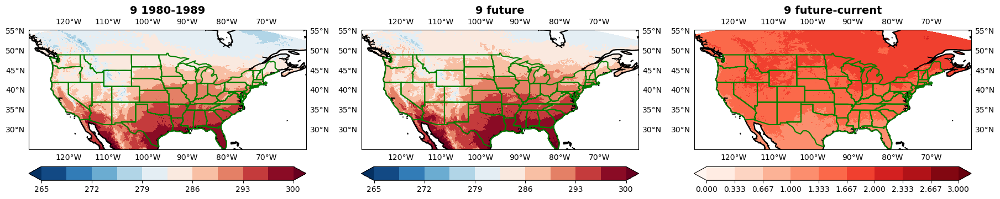

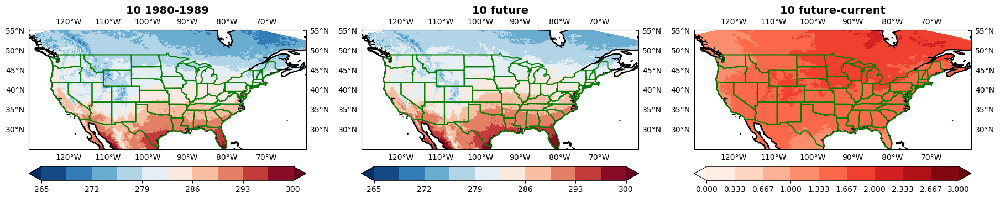

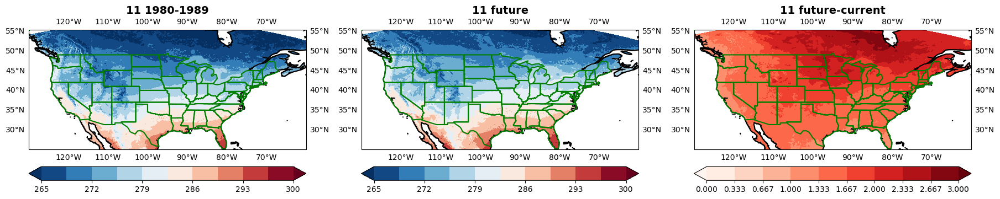

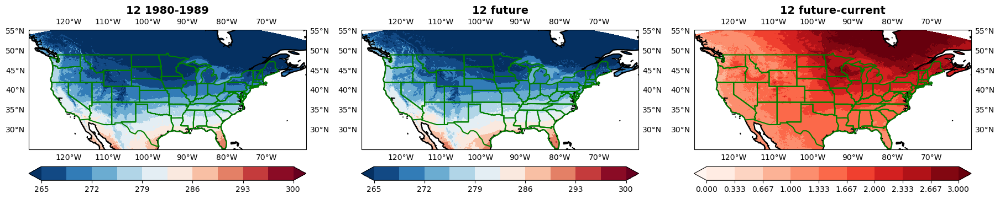

In [57]:
flnm_c = dir_o  + 'GWBT_CONUS404_yyyymm_mean_1980-1989.nc'
flnm_f = dir_of + 'GWBT_CONUS404_yyyymm_mean_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_3d = ds_c.GWBT.mean(dim='year')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_3d = ds_f.GWBT.mean(dim='year')

for month in range(12):
    title_new = [str(month +1) + " " + title for title in title_s]
    plot_p3(data1_3d[month], data2_3d[month], lat_2d, lon_2d, 265, 300, 11, 3, title_new, color_1d)
 

- 3.2) Monthly Maximum GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_yyyymm_max_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_yyyymm_max_1980-1989.nc


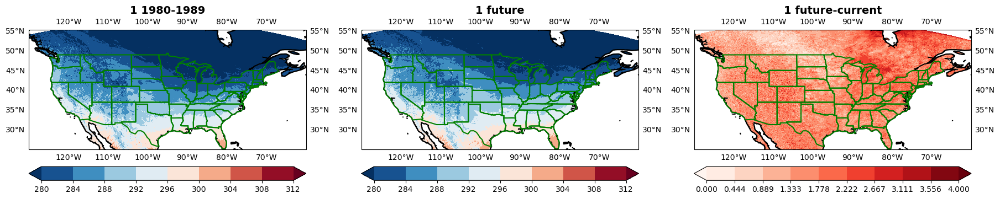

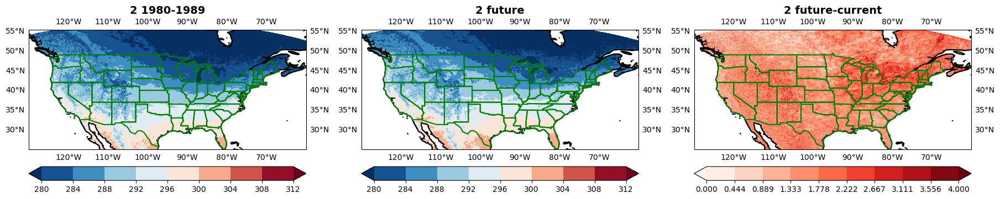

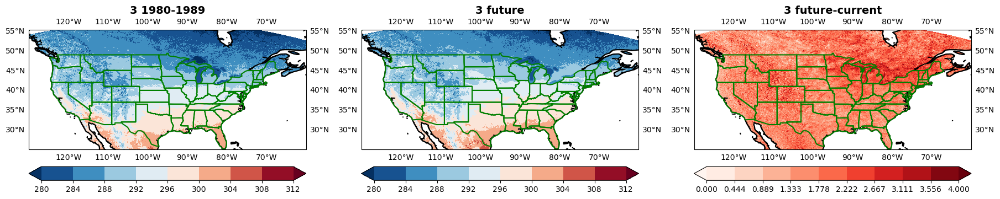

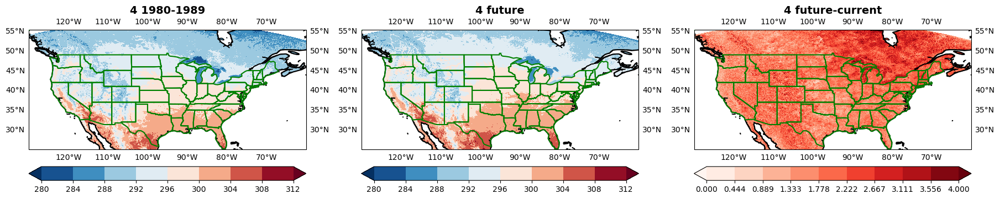

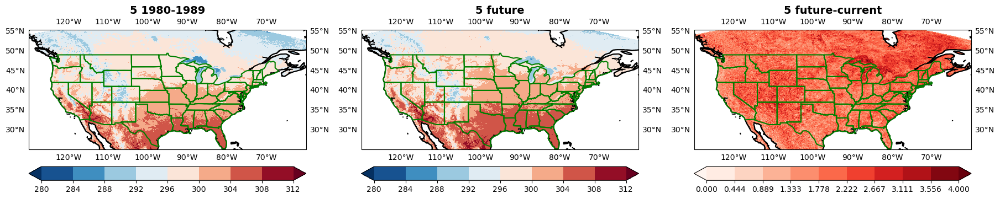

...

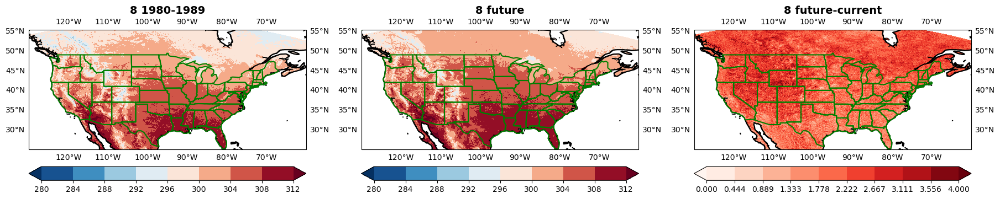

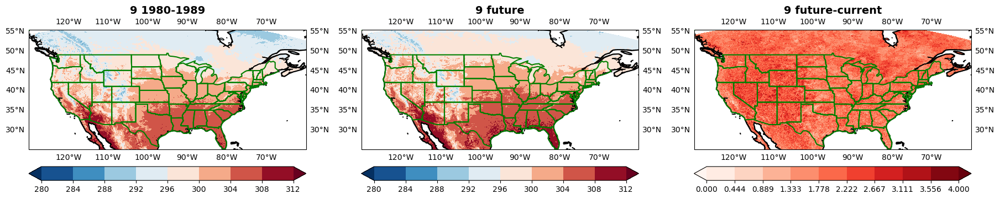

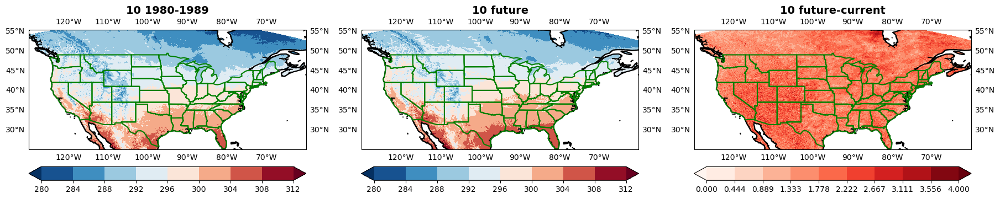

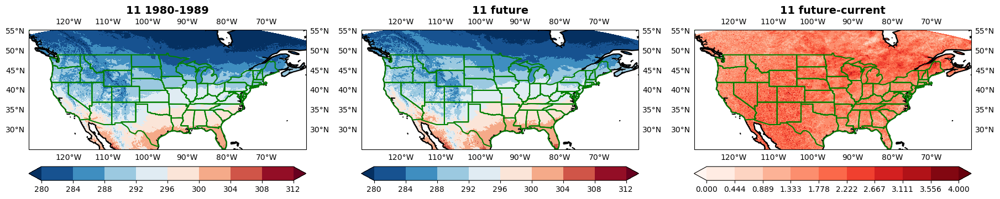

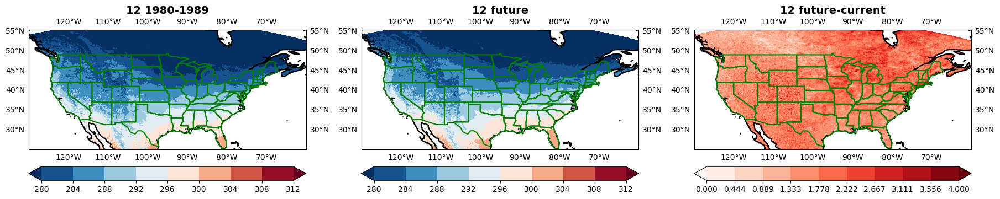

In [61]:
flnm_c = dir_o  + 'GWBT_CONUS404_yyyymm_max_1980-1989.nc'
flnm_f = dir_of + 'GWBT_CONUS404_yyyymm_max_1980-1989.nc'
color_1d = ['RdBu_r', 'RdBu_r', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_3d = ds_c.GWBT.mean(dim='year')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_3d = ds_f.GWBT.mean(dim='year')

for month in range(12):
    title_new = [str(month +1) + " " + title for title in title_s]
    plot_p3(data1_3d[month], data2_3d[month], lat_2d, lon_2d, 280, 312, 9, 4, title_new, color_1d)


- 4) Trend of monthly changes 

In [19]:
for nm in range(len(method_s)):
    flnm_i = dir_o + 'GWBT_CONUS404_yyyymm_' + method_s[nm] + '_1980-1989.nc'
    with xr.open_dataset(flnm_i) as ds:
        print(flnm_i, ds)
        data_4d = ds['GWBT']
        n_year = data_4d.shape[0]
        n_month = data_4d.shape[1]
        n_lat_conus  = data_4d.shape[2]
        n_lon_conus  = data_4d.shape[3]
        
        mk_3d = np.zeros((2, n_lat_conus, n_lon_conus)) 
        for month in range(n_month):
            flnm_o = dir_o + 'GWBT_CONUS404_' + str(month+1).zfill(2) + '_' + method_s[nm]+ '_mk_1980-1989.nc'
            print(flnm_o)
            if os.path.exists(flnm_o):
                print(flnm_o, 'exist')
            else:
                for ni in range(n_lat_conus):            
                    for nj in range(n_lon_conus):
                        res = mk.original_test(data_4d[:, month, ni, nj])
                     
                        mk_3d[0, ni, nj] = res.p
                        mk_3d[1, ni, nj] = res.slope
         
                da = xr.DataArray(data = mk_3d,
                          coords={'mk': range(2), 'lat': ds.lat, 'lon': ds.lon}, 
                          dims=["mk", "y", "x"],
                          attrs = {'mk':'0:p_value, 1:slope', 'script':'Ming Ge: wgbt_wrf_cmp.ipynb' })
                    
                ds = da.to_dataset(name='GWBT')         
                ds.to_netcdf(flnm_o)
                print(flnm_o)   

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_yyyymm_mean_1980-1989.nc <xarray.Dataset>
Dimensions:  (year: 10, month: 12, y: 1015, x: 1367)
Coordinates:
  * year     (year) int64 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
    lat      (y, x) float32 ...
    lon      (y, x) float32 ...
Dimensions without coordinates: y, x
Data variables:
    GWBT     (year, month, y, x) float64 ...
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_01_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_01_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_02_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_02_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_03_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_03_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_04_mean_mk_1980-1989.nc
/glade/campaig

Future trend by month

In [20]:
for nm in range(len(method_s)):
    flnm_i = dir_of + 'GWBT_CONUS404_yyyymm_' + method_s[nm] + '_1980-1989.nc'
    with xr.open_dataset(flnm_i) as ds:
        print(flnm_i, ds)
        data_4d = ds['GWBT']
        n_year = data_4d.shape[0]
        n_month = data_4d.shape[1]
        n_lat_conus  = data_4d.shape[2]
        n_lon_conus  = data_4d.shape[3]
        
        mk_3d = np.zeros((2, n_lat_conus, n_lon_conus)) 
        for month in range(n_month):
            flnm_o = dir_of + 'GWBT_CONUS404_' + str(month+1).zfill(2) + '_' + method_s[nm]+ '_mk_1980-1989.nc'
            print(flnm_o)
            if os.path.exists(flnm_o):
                print(flnm_o, 'exist')
            else:
                for ni in range(n_lat_conus):            
                    for nj in range(n_lon_conus):
                        res = mk.original_test(data_4d[:, month, ni, nj])
                     
                        mk_3d[0, ni, nj] = res.p
                        mk_3d[1, ni, nj] = res.slope
         
                da = xr.DataArray(data = mk_3d,
                          coords={'mk': range(2), 'lat': ds.lat, 'lon': ds.lon}, 
                          dims=["mk", "y", "x"],
                          attrs = {'mk':'0:p_value, 1:slope', 'script':'Ming Ge: wgbt_wrf_cmp.ipynb' })
                    
                ds = da.to_dataset(name='GWBT')         
                ds.to_netcdf(flnm_o)
                print(flnm_o)   

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_yyyymm_mean_1980-1989.nc <xarray.Dataset>
Dimensions:  (year: 10, month: 12, y: 1015, x: 1367)
Coordinates:
  * year     (year) int64 1980 1981 1982 1983 1984 1985 1986 1987 1988 1989
  * month    (month) int64 1 2 3 4 5 6 7 8 9 10 11 12
    lat      (y, x) float32 ...
    lon      (y, x) float32 ...
Dimensions without coordinates: y, x
Data variables:
    GWBT     (year, month, y, x) float64 ...
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_01_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_01_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_02_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_02_mean_mk_1980-1989.nc exist
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_03_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_03_mean_mk_1980-1989.nc exist
/gla

- 4.1) Trend of monthly mean

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_01_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_01_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_02_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_02_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_03_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_03_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_04_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_04_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_05_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_05_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_06_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_06_mean_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT

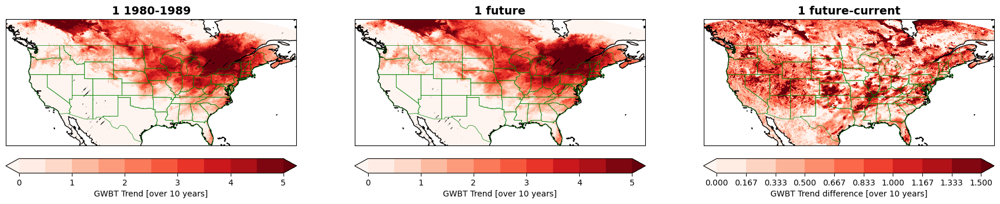

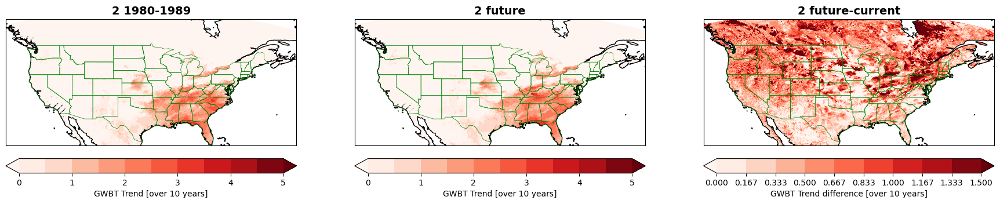

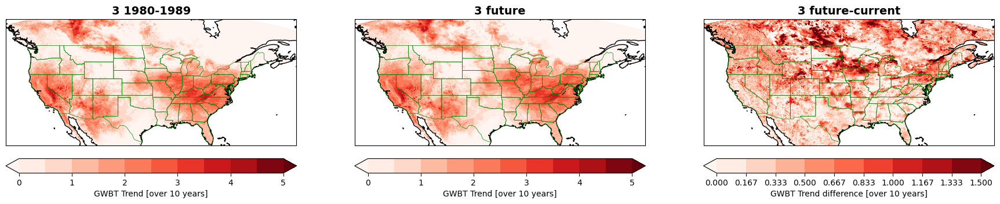

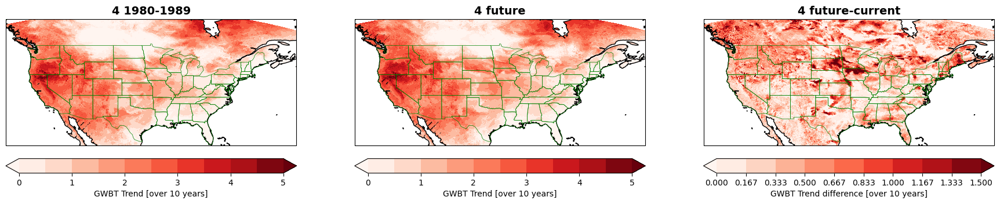

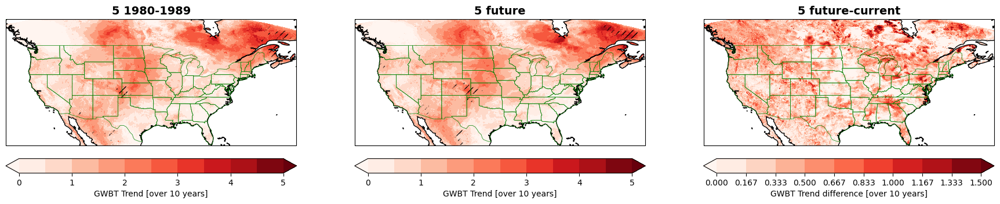

...

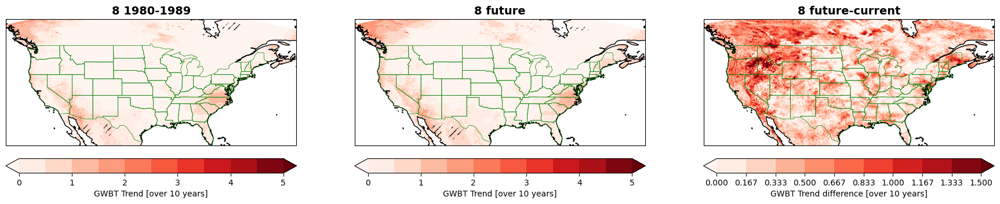

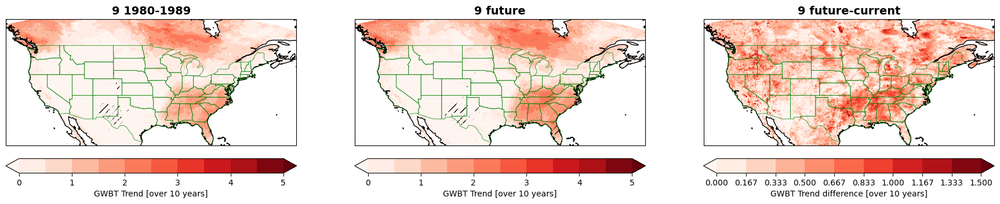

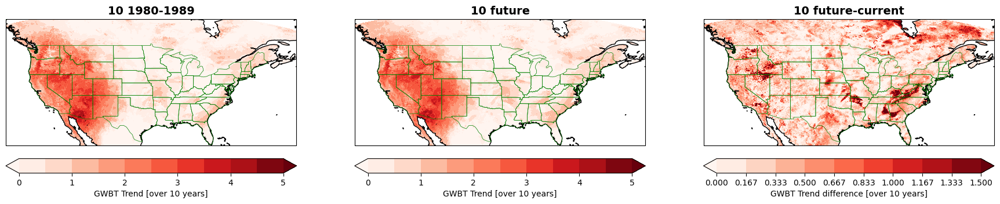

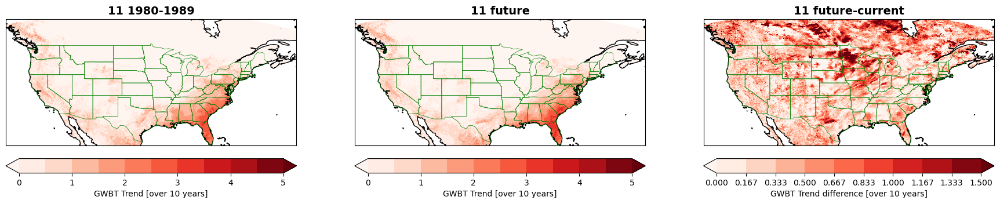

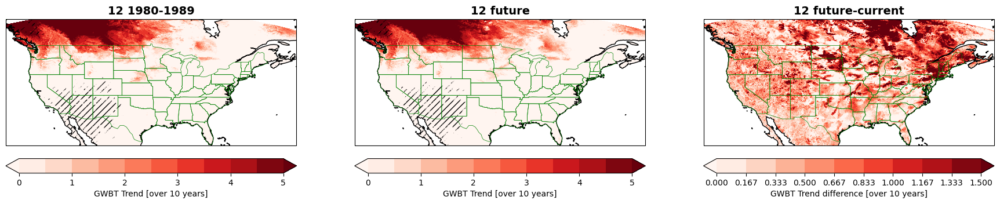

In [21]:
color_1d = ['RdBu_r', 'RdBu_r', 'RdBu_r']
title_s = ['1980-1989','future', 'future-current']

for month in range(1,13):
    flnm_c = dir_o  + 'GWBT_CONUS404_' + str(month).zfill(2) + '_mean_mk_1980-1989.nc'
    flnm_f = dir_of + 'GWBT_CONUS404_' + str(month).zfill(2) + '_mean_mk_1980-1989.nc'
    with xr.open_dataset(flnm_c) as ds_c:
        print(flnm_c)
        data1 = ds_c.GWBT 
        lat_2d = ds_c.lat
        lon_2d = ds_c.lon
    
    with xr.open_dataset(flnm_f) as ds_f:
        print(flnm_f)
        data2 = ds_f.GWBT 

    title_new = [str(month) + " " + title for title in title_s]
    plot_hatches_p3(data1, data2, lat_2d, lon_2d, n_year, method, title_new, 1.5, vmin=0, vmax=5, n_level=11)

- 4.2 ) Trend of monthly maximum GWBT

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_01_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_01_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_02_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_02_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_03_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_03_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_04_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_04_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_05_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_05_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_06_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_06_max_mk_1980-1989.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_07

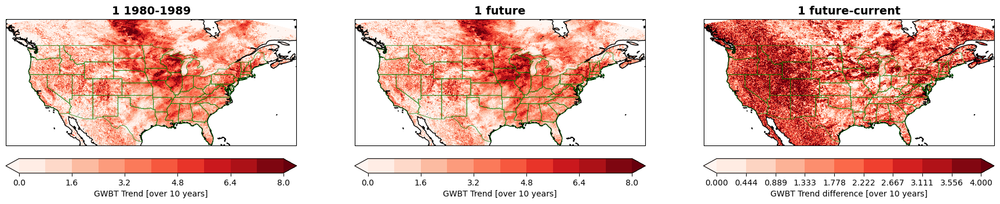

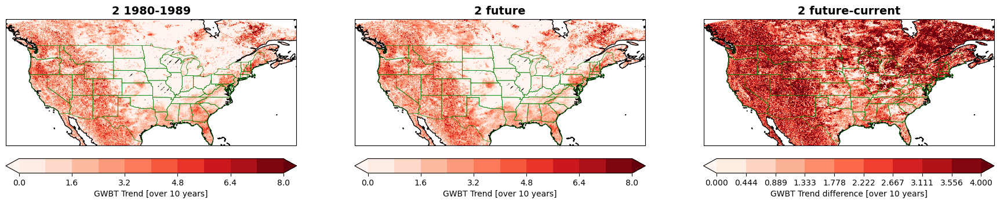

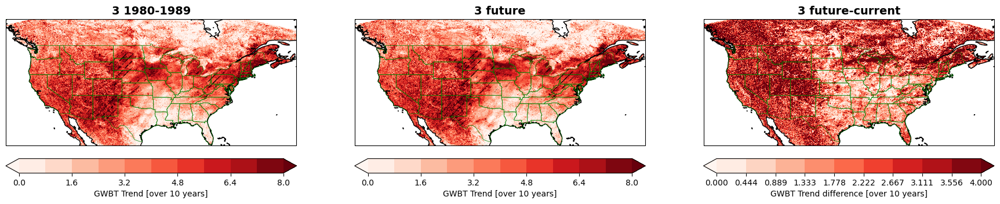

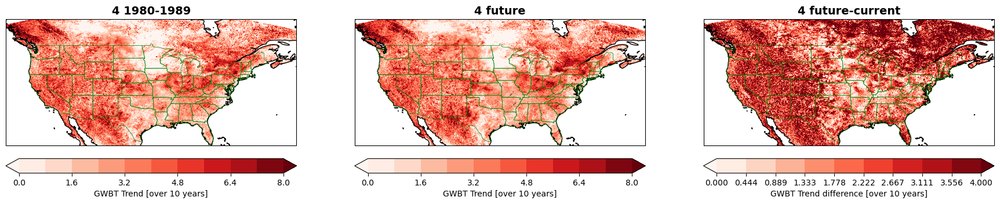

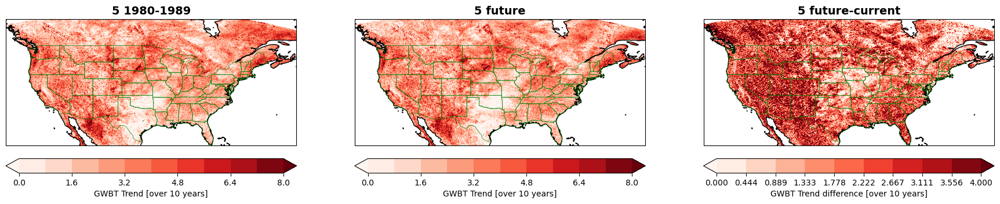

...

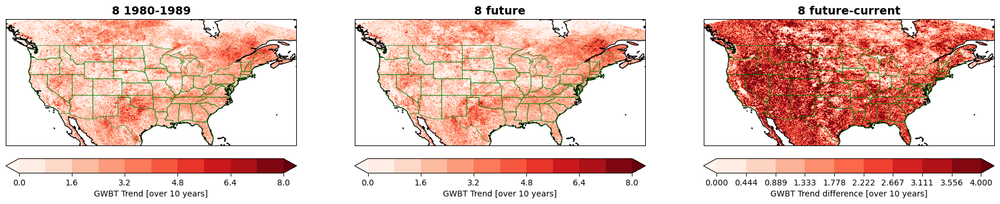

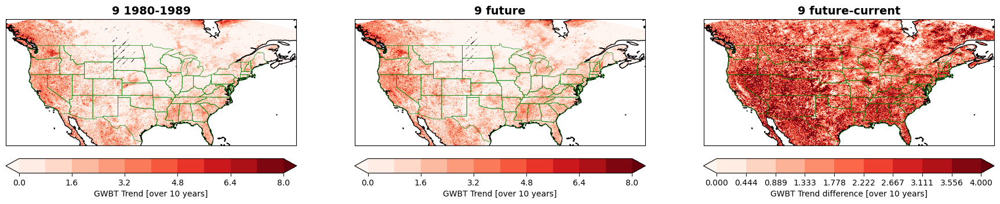

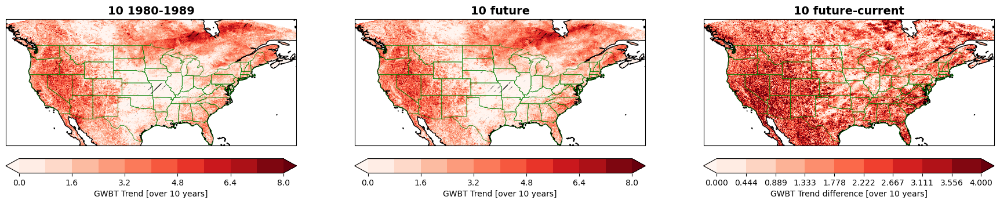

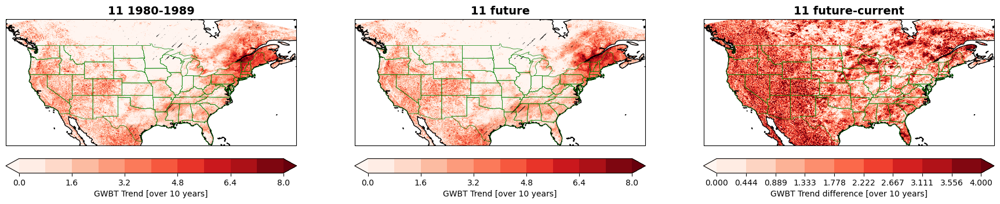

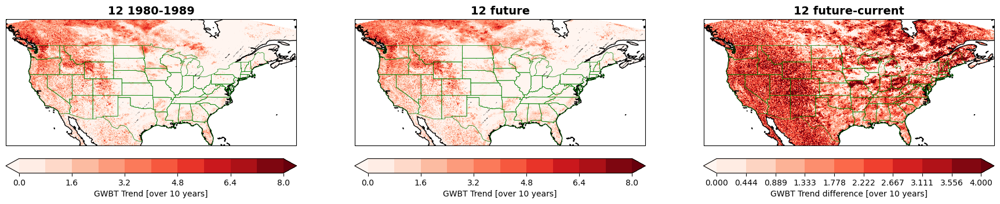

In [22]:
color_1d = ['RdBu_r', 'RdBu_r', 'RdBu_r']
title_s = ['1980-1989','future', 'future-current']

for month in range(1,13):
    flnm_c = dir_o  + 'GWBT_CONUS404_' + str(month).zfill(2) + '_max_mk_1980-1989.nc'
    flnm_f = dir_of + 'GWBT_CONUS404_' + str(month).zfill(2) + '_max_mk_1980-1989.nc'
    with xr.open_dataset(flnm_c) as ds_c:
        print(flnm_c)
        data1 = ds_c.GWBT 
        lat_2d = ds_c.lat
        lon_2d = ds_c.lon
    
    with xr.open_dataset(flnm_f) as ds_f:
        print(flnm_f)
        data2 = ds_f.GWBT 

    title_new = [str(month) + " " + title for title in title_s]
    plot_hatches_p3(data1, data2, lat_2d, lon_2d, n_year, method, title_new, 4, vmin=0, vmax=8, n_level=11)

- 5.1) Annual average number of days exceed Black Flag days (1980-1989) 

In [26]:
tbf = 305.372  # 90F -> K

n_month = 12
n_hour = 24

In [27]:
flnm_o = dir_of + 'GWBT' + '_CONUS404_annual_TBFday_1980-1989.nc'
    
if os.path.exists(flnm_o):
    print(flnm_o, 'exist')
else: 
    is_first = True
    
    for year in range(year_s, year_e + 1):
        for month in range(1, 12 + 1):
            flnm = dir_if + 'GWBT_' + str(year) + str(month).zfill(2) + '_CONUS404.nc'
            
            with xr.open_dataset(flnm) as ds:
                print(flnm)
                data_0 = ds['__xarray_dataarray_variable__'].values
                data_d = np.max(data_0.reshape((int(data_0.shape[0]/24), 24, data_0.shape[1], data_0.shape[2])),
                                         axis = 1)
                
                if is_first == True:
                    n_lat_conus = data_0.shape[1]
                    n_lon_conus = data_0.shape[2]
                    data_3d = np.zeros((n_year, n_lat_conus, n_lon_conus))
                    is_first = False
                
                # concatenate/append numpy data  
                if month == 1:
                    data_y = data_d.copy()               
                else:
                    data_y = np.append(data_y, data_d, axis=0)
                
                if month == 12:
                    data_y = data_y - tbf
                    data_3d[year-year_s] = np.sum(data_y >0,  axis=0)
                    print(data_y.shape)
                    
    da = xr.DataArray(data = data_3d,
                    coords = {'time': range(year_s, year_e + 1),'lat': ds.lat, 'lon': ds.lon}, 
                    dims = ["time", "y", "x"])
            
        
    # create and write out dataset 
    ds = da.to_dataset(name = 'n_TBF' )         
    ds.to_netcdf(flnm_o)
    print(flnm_o)     

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_TBFday_1980-1989.nc exist


/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_TBFday.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_TBFday_1980-1989.nc


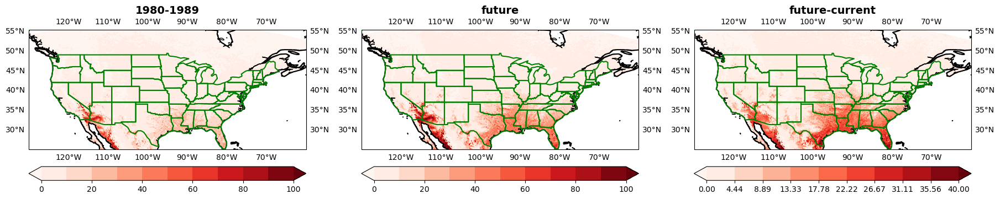

In [10]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_TBFday.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_TBFday_1980-1989.nc'
color_1d = ['Reds', 'Reds', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_2d = ds_c.n_TBF[:10].mean(dim='time')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_2d = ds_f.n_TBF.mean(dim='time')

plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, 0, 100, 11, 40, title_s, color_1d)

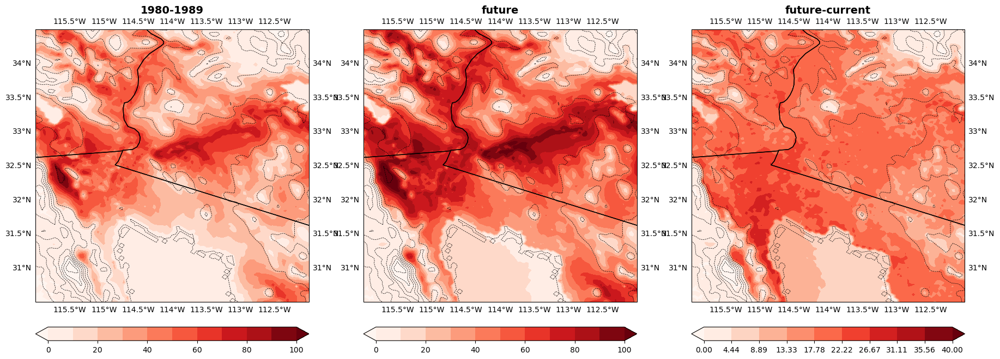

In [60]:
plot_p3_yuma(data1_2d, data2_2d, lat_2d, lon_2d, 0, 100, 11, 40, title_s, color_1d);

- 5.2) Number of days exceed Black Flag days for each hour of the day

In [29]:
mon_e = 12
n_hour = 24
flnm_o = dir_of + 'GWBT' + '_CONUS404_annual_TBFday_hourly_1980-1989.nc'
    
if os.path.exists(flnm_o):
    print(flnm_o, 'exist')
else: 
    data_4d = np.zeros((n_year, n_hour, n_lat, n_lon))
    
    for year in range(year_s, year_e + 1):
        for month in range(1, mon_e + 1):
            flnm = dir_if + 'GWBT_' + str(year)+ str(month).zfill(2) + '_CONUS404.nc'
            
            with xr.open_dataset(flnm) as ds:
                print(flnm)
                data_0 = ds['__xarray_dataarray_variable__'].values
                data_d = data_0.reshape((int(data_0.shape[0]/24), 24, n_lat, n_lon))
                data_4d[year-year_s] = data_4d[year-year_s] + np.sum(data_d>tbf,  axis=0)
                    
    da = xr.DataArray(data = data_4d,
                    coords = {'year': range(year_s, year_e + 1),
                              'hour': range(1, n_hour+1),
                              'lat': ds.lat, 'lon': ds.lon}, 
                    dims = ["year", "hour",  "y", "x"])
            
        
    # create and write out dataset 
    ds = da.to_dataset(name = 'n_TBF' )         
    ds.to_netcdf(flnm_o)
    print(flnm_o)  

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_TBFday_hourly_1980-1989.nc exist


/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_annual_TBFday_hourly.nc
/glade/campaign/mmm/c3we/mingge/DOD/GWBT_Future/GWBT_CONUS404_annual_TBFday_hourly_1980-1989.nc
0 33
1 27
2 27
13 4
14 15
15 48
16 133
17 162
18 134
19 127
20 99
21 73
22 51
23 43


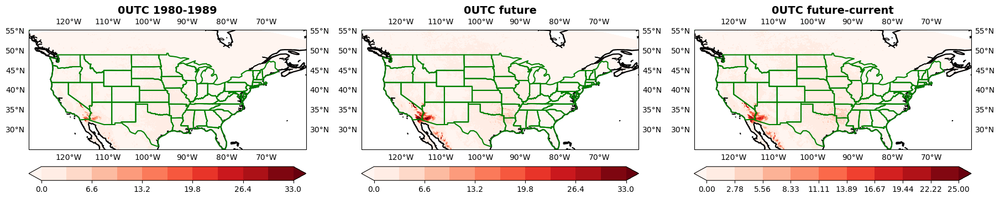

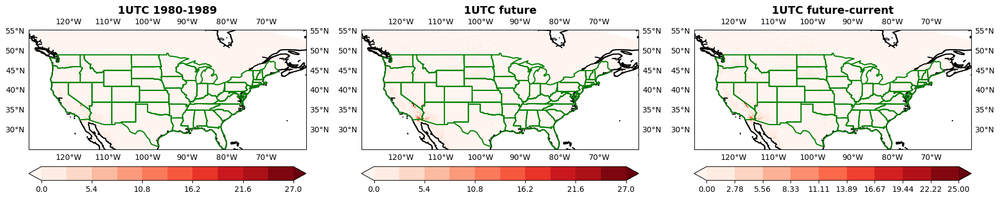

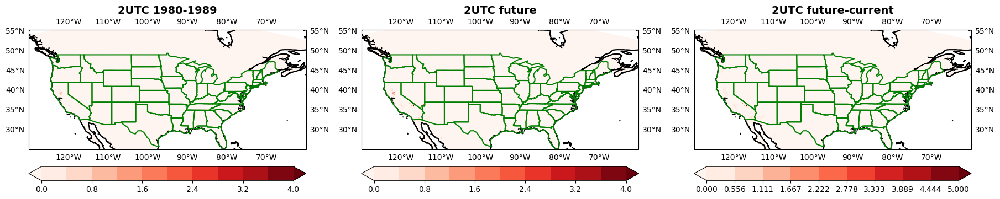

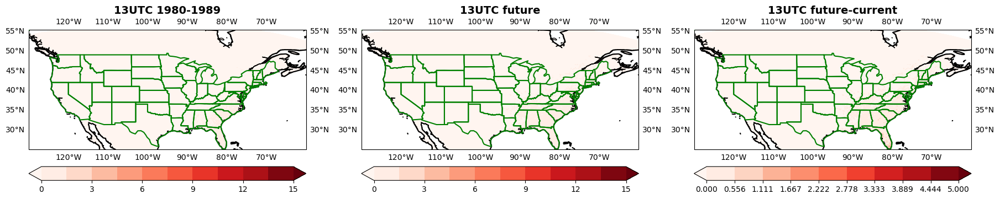

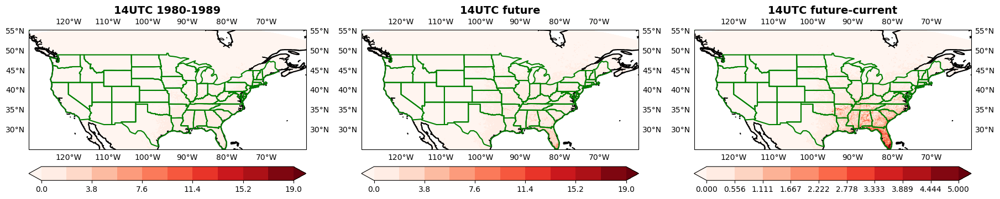

...

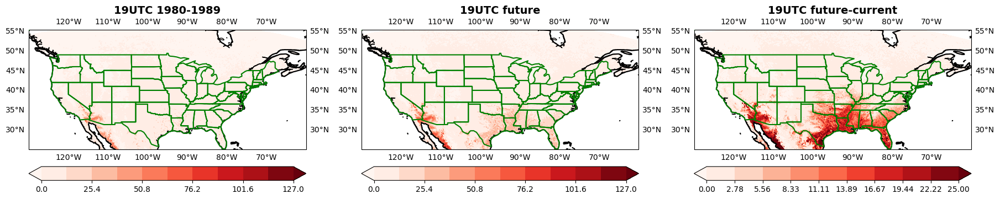

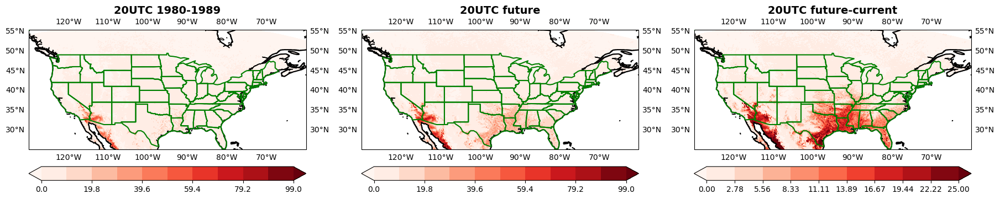

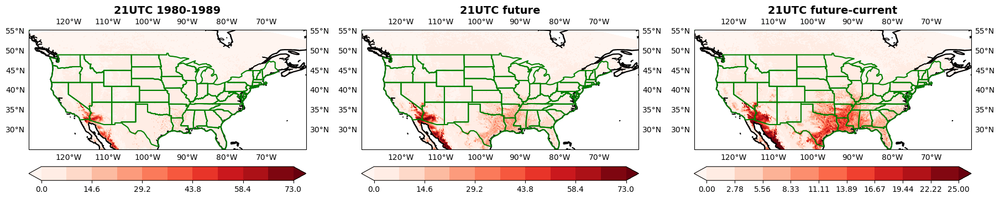

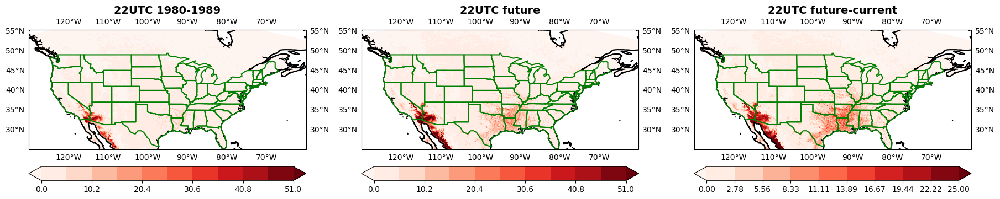

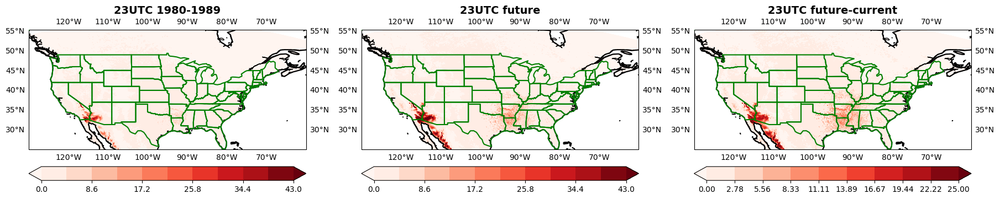

In [61]:
flnm_c = dir_o  + 'GWBT_CONUS404_annual_TBFday_hourly.nc'
flnm_f = dir_of + 'GWBT_CONUS404_annual_TBFday_hourly_1980-1989.nc'
color_1d = ['Reds', 'Reds', 'Reds']
title_s = ['1980-1989','future', 'future-current']

with xr.open_dataset(flnm_c) as ds_c:
    print(flnm_c)
    data1_3d = ds_c.n_TBF[:10].mean(dim='year')
    lat_2d = ds_c.lat
    lon_2d = ds_c.lon
    
with xr.open_dataset(flnm_f) as ds_f:
    print(flnm_f)
    data2_3d = ds_f.n_TBF.mean(dim='year')

for hour in range(24):
    data1_2d = data1_3d[hour]
    data2_2d = data2_3d[hour]
    
    vmax_0 = data1_2d.max()
    #print(vmax_0)
    title_new = [str(hour) + "UTC " + title for title in title_s]
    if vmax_0 > 30:
        vmax = int(vmax_0*0.8)
        print(hour,vmax)
        plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, 0, vmax, 11, 25, title_new, color_1d)
    elif vmax_0 >=1:
        print(hour,vmax)
        vmax = int(vmax_0)
        plot_p3(data1_2d, data2_2d, lat_2d, lon_2d, 0, vmax, 11, 5, title_new, color_1d)

- 5.3) Daily average number of days  exceed Black Flag days (1980-1989)

In [57]:

tbf = 305.372 

n_365 = 365
year_e = 1989

flnm_o = dir_o + 'GWBT' + '_CONUS404_daily_TBFday_1980-1989.nc'
    
if os.path.exists(flnm_o):
    print(flnm_o, 'exist')
else: 
    is_first = True
    
    for month in range(1, 12 + 1):
        for year in range(year_s, year_e + 1):
            flnm = dir_i + 'GWBT_' + str(year) + str(month).zfill(2) + '_CONUS404.nc'
            
            with xr.open_dataset(flnm) as ds:
                print(flnm)
                data_0 = ds['GWBT'].values
                #data_0 = ds['__xarray_dataarray_variable__'].values
                # daily maximum
                data_d = np.max(data_0.reshape((int(data_0.shape[0]/24), 24, data_0.shape[1], data_0.shape[2])),
                                         axis = 1)
                
                if calendar.isleap(year) and month == 2:
                    data_d = data_d[None,:28,:,:]
                else:
                    data_d = data_d[None,:,:,:]
                
                if is_first == True:
                    n_lat_conus = data_0.shape[1]
                    n_lon_conus = data_0.shape[2]
                    data_3d = np.zeros((n_365, n_lat_conus, n_lon_conus))
                    is_first = False
                    
                # concatenate/append numpy data  
                if year == year_s:
                    data_y = data_d.copy()    
                    print(data_y.shape)
                else:
                    data_y = np.append(data_y, data_d, axis=0) 
                    print(data_y.shape)
            
                if year == year_e:
                    data_y = data_y - tbf
                    data_3d = np.sum(data_y >0,  axis=0)
                    print(data_3d.shape)
                    
        # concatenate/append numpy data  
        if month == 1:
            data_yy = data_3d.copy()               
        else:
            data_yy = np.append(data_yy, data_3d, axis=0)
                
    da = xr.DataArray(data = data_yy,
                    coords = {'time': range(1, n_365 + 1),'lat': ds.lat, 'lon': ds.lon}, 
                    dims = ["time", "y", "x"])
            
    # create and write out dataset 
    ds = da.to_dataset(name = 'n_TBF' )         
    ds.to_netcdf(flnm_o)
    print(flnm_o)                              

/glade/campaign/mmm/c3we/mingge/DOD/GWBT_CONUS404_daily_TBFday_1980-1989.nc exist


In [56]:
data_yy.shape

(365, 1015, 1367)

In [35]:
data_y = data_y - tbf
data_3d = np.sum(data_y >0,  axis=0)
print(data_3d.max())

0
